### Data Augmentation, 데이터 증강
- 이미지의 종류와 개수가 적으면, CNN 모델의 성능이 떨어질 수 밖에 없다. 또한 몇 안되는 이미지로 훈련시키면 과적합이 발생한다.
- CNN 모델의 성능을 높이고 과적합을 개선하기 위해서는 이미지의 종류와 개수가 많아야 한다. 즉, 데이터의 양을 늘려야 한다.
- 이미지 데이터는 학습 데이터를 수집하여 양을 늘리기 쉽지 않기 때문에, 원본 이미지를 변형 시켜서 양을 늘릴 수 있다.
- Data Augmentation을 통해 원본 이미지에 다양한 변형을 주어서 학습 이미지 데이터를 늘리는 것과 유사한 효과를 볼 수 있다.
- 원본 학습 이미지의 개수를 늘리는 것이 아닌 매 학습 마다 개별 원본 이미지를 변형해서 학습을 수행한다.  
  <sub>*예를 들어, 100장의 이미지가 200장, 300장으로 늘어나는 것이 아닌 효과를 주어 증강하는 것이다(용량 늘지 않음).</sub>

<img src='./images/data_augmentation.png' width='400' style='margin-left: 30px'>

#### 공간 레벨 변형
- 좌우 또는 상하 반전, 특정 영역만큼 확대, 축소, 회전 등으로 변형시킨다.

<img src="./images/spatial.png" width="500px">

#### 픽셀 레벨 변형
- 밝기, 명암, 채도, 색상 등을 변형시킨다.
  
<img src="./images/pixel.png" width="200" style="margin-left: 10px">

In [1]:
# with문으로 파일을 열고 f로 할당
with open('./datasets/animals/translate.py') as f:
    # 파일을 내용을 읽어와 content에 저장
    content = f.readline()
    # 중괄호 사이의 문장을 찾아서 가져오고
    # eval을 사용하여 문자열 안에 갇혀있는 문장을 실제 딕셔너리로 변환
    contents1 = eval(content[content.index('{'):content.index('}') + 1])
    # 키와 값을 반대로 변경하여 저장
    contents2 = {v : k for k, v in contents1.items()}

print(contents1, contents2, sep='\n')

{'cane': 'dog', 'cavallo': 'horse', 'elefante': 'elephant', 'farfalla': 'butterfly', 'gallina': 'chicken', 'gatto': 'cat', 'mucca': 'cow', 'pecora': 'sheep', 'scoiattolo': 'squirrel', 'dog': 'cane', 'elephant': 'elefante', 'butterfly': 'farfalla', 'chicken': 'gallina', 'cat': 'gatto', 'cow': 'mucca', 'spider': 'ragno', 'squirrel': 'scoiattolo'}
{'dog': 'cane', 'horse': 'cavallo', 'elephant': 'elefante', 'butterfly': 'farfalla', 'chicken': 'gallina', 'cat': 'gatto', 'cow': 'mucca', 'sheep': 'pecora', 'squirrel': 'scoiattolo', 'cane': 'dog', 'elefante': 'elephant', 'farfalla': 'butterfly', 'gallina': 'chicken', 'gatto': 'cat', 'mucca': 'cow', 'ragno': 'spider', 'scoiattolo': 'squirrel'}


In [2]:
from glob import glob
import os

# 이미지가 저장되어 있는 경로 지정
root = './datasets/animals/original/'

# 해당 경로를 통해 이미지 폴더를 찾아옴
# glob: 파일 경로와 이름 패턴을 사용하여 파일을 찾을 수 있게 해주는 모듈
# *: 모든 문자열을 대체
directories = glob(os.path.join(root, '*'))

# 원래 정방향인데 에러나면 역방향으로 찾음
for directory in directories:
    try:
        # 디렉터리 이름을 해당하는 번역된 이름으로 변경
        os.rename(directory, os.path.join(root, contents1[directory[directory.rindex('\\') + 1:]]))
    except KeyError as e:
        # KeyError가 발생하면 번역된 이름이 아닌 원래 이름으로 변경
        os.rename(directory, os.path.join(root, contents2[directory[directory.rindex('\\') + 1:]]))

In [3]:
# 이미지가 저장되어 있는 경로 지정
root = './datasets/animals/original/'

# 해당 경로를 통해 이미지 폴더를 찾아옴
directories = glob(os.path.join(root, '*'))
# 폴더 이름 저장할 초기 list 생성
directory_names = []

for directory in directories:
    # 디렉토리의 이름을 찾아와서 list에 저장
    # rindex: 문자열에서 특정 문자 또는 부분 문자열의 마지막으로 발생하는 인덱스를 반환하는 메서드
    directory_names.append(directory[directory.rindex('\\') + 1:])

print(directory_names)

['butterfly', 'cat', 'chicken', 'cow', 'dog', 'elephant', 'horse', 'sheep', 'spider', 'squirrel']


In [4]:
# # 이미지가 저장되어 있는 경로 지정
# root = './datasets/animals/original/'

# # 이미지 별 폴더 안 이미지들의 파일명 변경
# for name in directory_names:
#     # os.listdir(): 지정된 디렉토리 내의 파일 목록 가져오기
#     # enumerate(): 함수를 사용하여 파일 목록에서 파일 이름과 해당 파일의 인덱스를 반환
#     for i, file_name in enumerate(os.listdir(os.path.join(root, name))):
#         # 이전 파일의 전체 경로
#         old_file = os.path.join(root + name + '/', file_name)
#         # 신규 파일 전체 경로 작성
#         new_file = os.path.join(root + name + '/', name + str(i + 1) + '.png')

#         # 이전 파일의 이름을 신규 파일로 변경
#         os.rename(old_file, new_file)

In [5]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# 경로 지정
root = './datasets/animals/original/'

# 이미지의 픽셀 값을 0에서 255 사이에서 0에서 1 사이의 값으로 조정
# ImageDataGenerator: 이미지 데이터를 증강하고 전처리하는 데 사용되는 클래스
idg = ImageDataGenerator(rescale=1./255)

# 디렉토리에서 이미지를 가져와 배치로 변환
# flow_from_directory(): 디렉토리를 통해서 가져옴
generator = idg.flow_from_directory(
    root,
    target_size=(250, 250),
    # 한번에 가져오면 하드웨어에 무리가가기 때문에 나눠서 가져오기
    batch_size=32,
    class_mode='categorical'
)

# 각 클랙스의 이름과 인덱스 출력
print(generator.class_indices)

Found 26179 images belonging to 10 classes.
{'butterfly': 0, 'cat': 1, 'chicken': 2, 'cow': 3, 'dog': 4, 'elephant': 5, 'horse': 6, 'sheep': 7, 'spider': 8, 'squirrel': 9}


In [6]:
# # cv2로 변환된 파일 불러오기 위해 opencv-python 설치
# pip install opencv-python

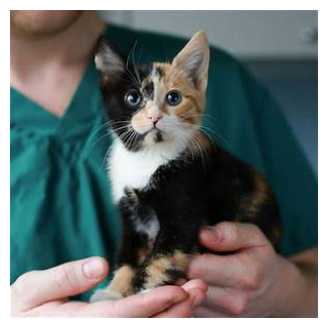

In [7]:
import cv2
import matplotlib.pyplot as plt

# generator에 저장된 경로로 이미지를 불러와 RGB로 변환
image = cv2.cvtColor(cv2.imread(generator.filepaths[3000]), cv2.COLOR_BGR2RGB)

# 이미지 출력 함수 선언
def show_image(image):
    plt.figure(figsize=(4, 4))
    plt.imshow(image)
    plt.axis('off')

# 함수 사용을 통해 이미지 출력
show_image(image)

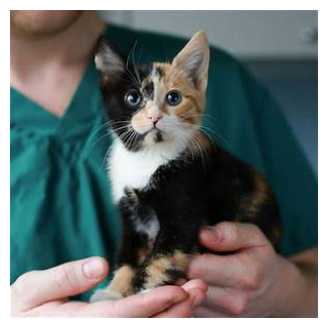

In [8]:
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Horizontal Filp: 좌우반전 적용
# 적용하더라도 반드시 변환되지 않는다. 특정 확률로 랜덤하게 적용하기 때문이다.
idg = ImageDataGenerator(horizontal_flip=True)

# ImageDataGenerator는 배치 사이즈를 포함한 4차원으로 연산되기 때문에
# 기존 image를 한 차원 증가시켜준다.
# 현재 3차원에서 4차원으로 증가 (batch가 있다면 4차원으로 진행하지 않아도 됨)
image_batch = np.expand_dims(image, axis=0)

# 4차원 이미지(배치 사이즈 포함)를 fit에 전달한다.
idg.fit(image_batch)

# fit한 뒤 flow에 다시 넣어준다.
# fit 후 flow로 가져와진 데이터를 generator로 변환한다(fit-transform과 유사).
data_generator = idg.flow(image_batch)

# 적용된 이미지를 next로 가져온다.
aug_image_batch = next(data_generator)

# 이미지를 시각화하기 위해서 한 차원 감소시킨 3차원으로 변경해준다.
# 이미지를 출력하기 위해서는 3차원으로 감소해야 하기 때문에 squeeze 사용하여 차원 축소
aug_image = np.squeeze(aug_image_batch)

# 실수에서 정수로 변경 후 출력해준다.
show_image(aug_image.astype('int'))

# augmentation은 확률적(랜덤)으로 적용된다.

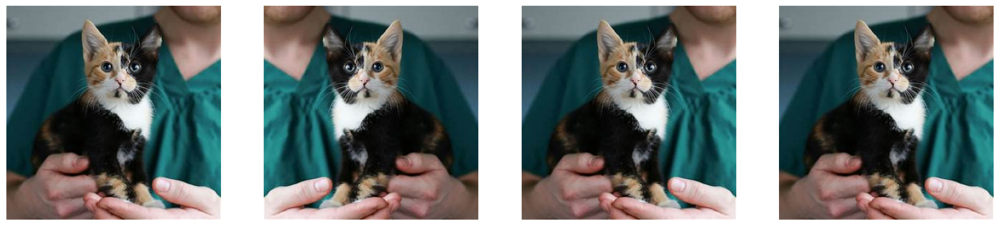

In [9]:
# 이미지 출력 개수 지정
N_IMAGES = 4

# 그래프 사이즈 지정
fig, axs = plt.subplots(1, N_IMAGES, figsize=(20, 8))

# Horizontal Filp (좌우반전) 적용된 여러 이미지 객체 가져와 출력
for i in range(N_IMAGES):
    # 적용된 이미지를 next로 가져온다.
    aug_image_batch = next(data_generator)
    # 차원 감소
    aug_image = np.squeeze(aug_image_batch)
    # 정수로 형변환
    aug_image = aug_image.astype('int')
    # 출력
    axs[i].imshow(aug_image)
    # 축 비활성화
    axs[i].axis('off')

In [10]:
# 이미지 출력 함수 선언
def show_aug_image_batch(image, idg, n_images=4, to_int=True):
    # 차원 증가
    image_batch = np.expand_dims(image, axis=0)
    # Horizontal Filp (좌우반전)을 적용하여 훈련
    idg.fit(image_batch)
    # 이미지 담기
    data_generator = idg.flow(image_batch)

    # 그래프 사이즈 지정
    fig, axs = plt.subplots(1, n_images, figsize=(n_images * 5, 8))

    # 반복하여 객체 가져오기:
    for i in range(N_IMAGES):
        # aug 적용된 이미지 next로 호출
        aug_image_batch = next(data_generator)
        # 이미지 시각화를 위해 차원 감소
        aug_image = np.squeeze(aug_image_batch)
        # 이미지가 정수 타입이 아니라면:
        if to_int:
            # 정수로 형변환
            aug_image = aug_image.astype('int')

        # 이미지 출력
        axs[i].imshow(aug_image)
        # 축 비활성화
        axs[i].axis('off')

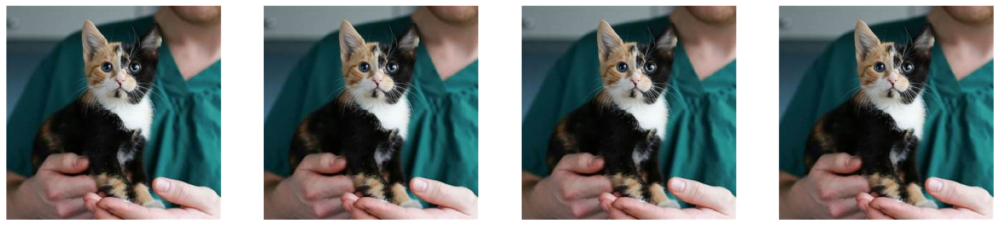

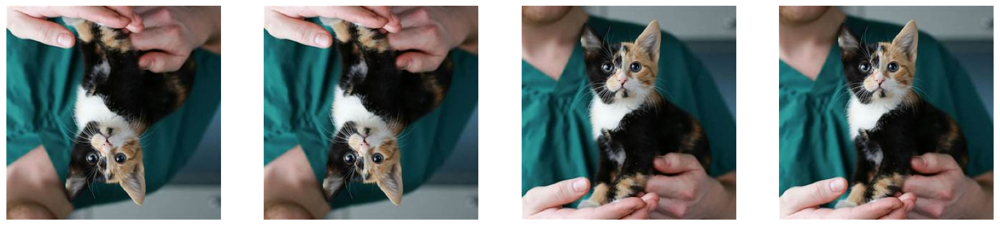

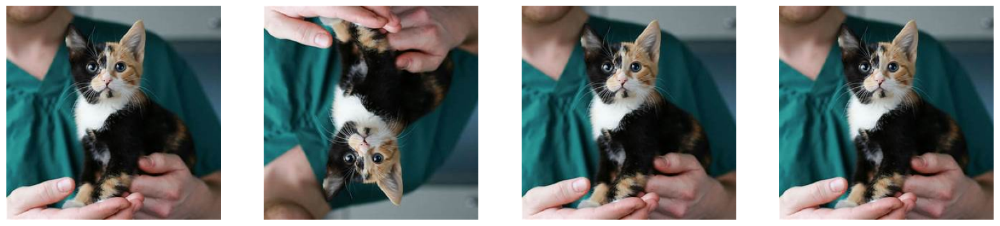

In [11]:
# 좌우 반전
idg = ImageDataGenerator(horizontal_flip=True)
show_aug_image_batch(image, idg)

# Vertical filp: 상하반전 적용
idg = ImageDataGenerator(vertical_flip=True)
show_aug_image_batch(image, idg)

# 상하, 좌우 반전
idg = ImageDataGenerator(horizontal_flip=True, vertical_flip=True)
show_aug_image_batch(image, idg)

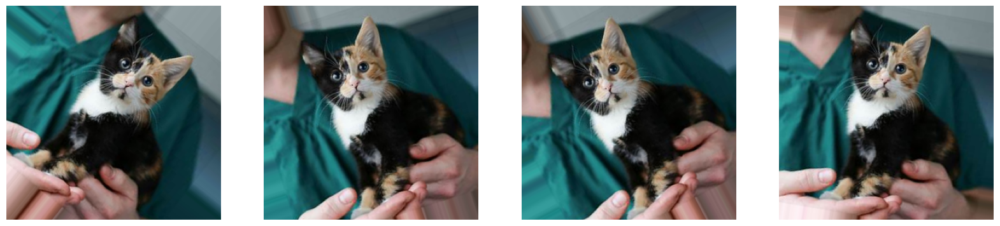

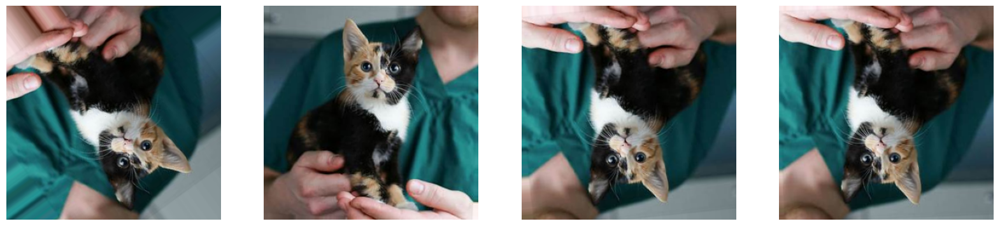

In [12]:
# rotation_range: 회전(0 ~ n)
idg = ImageDataGenerator(rotation_range=45)
show_aug_image_batch(image, idg)

# 좌우/상하 반전 및 회전
idg = ImageDataGenerator(horizontal_flip=True, vertical_flip=True, rotation_range=45)
show_aug_image_batch(image, idg)

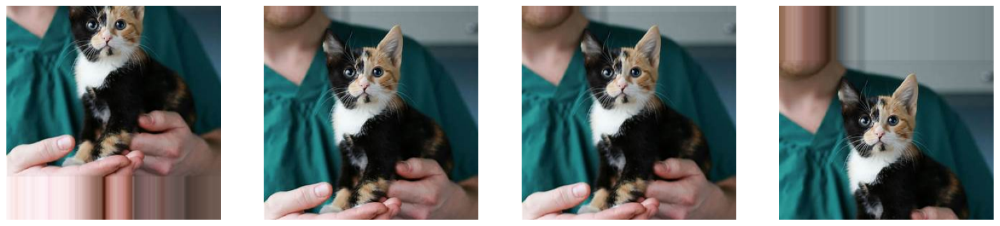

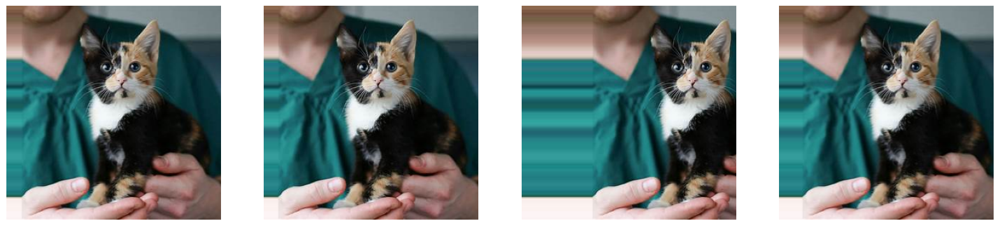

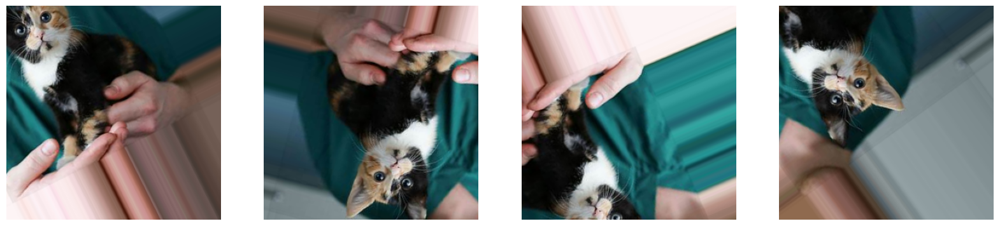

In [13]:
# 가까운 상하 가장자리를 늘려서 이동시킴
idg = ImageDataGenerator(width_shift_range=0.4)
show_aug_image_batch(image, idg)

# 가까운 좌우 가장자리를 늘려 이동시킴
idg = ImageDataGenerator(height_shift_range=0.4)
show_aug_image_batch(image, idg)

# 상하/좌우 늘리기, 상하/좌우 반전, 회전
idg = ImageDataGenerator(width_shift_range=0.4, height_shift_range=0.4, horizontal_flip=True, vertical_flip=True, rotation_range=45)
show_aug_image_batch(image, idg)

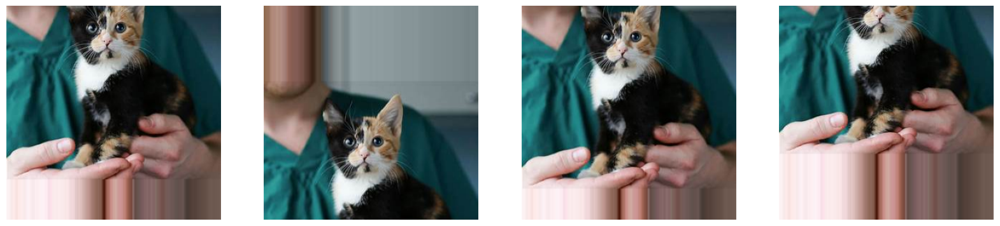

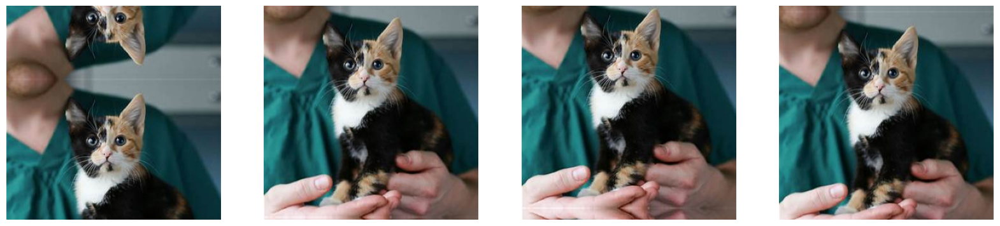

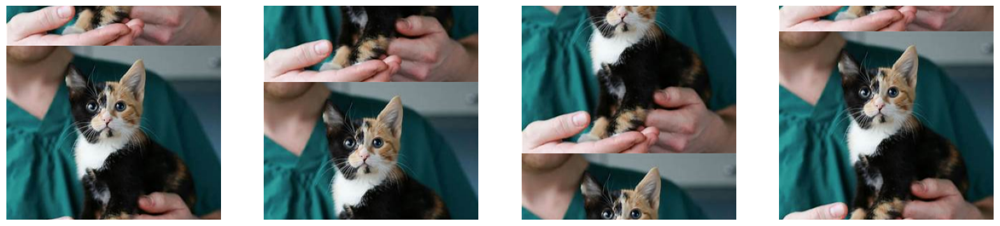

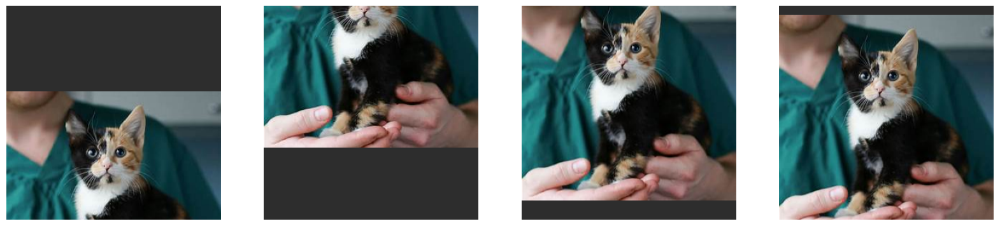

In [14]:
# 빈 공간을 가장 가까운 곳의 픽셀값으로 채움 (디폴트)
idg = ImageDataGenerator(width_shift_range=0.4, fill_mode='nearest')
show_aug_image_batch(image, idg)

# 빈 공간을 해당 영역 근처 공간으로 채움
idg = ImageDataGenerator(width_shift_range=0.4, fill_mode='reflect')
show_aug_image_batch(image, idg)

# 빈 공간을 잘려나간 이미지로 채움
idg = ImageDataGenerator(width_shift_range=0.4, fill_mode='wrap')
show_aug_image_batch(image, idg)

# 특정 픽셀값으로 채움
# fill_mode='constant'상수로 받는다, cval=41 컬러색상
idg = ImageDataGenerator(width_shift_range=0.4, fill_mode='constant', cval=45)
show_aug_image_batch(image, idg)

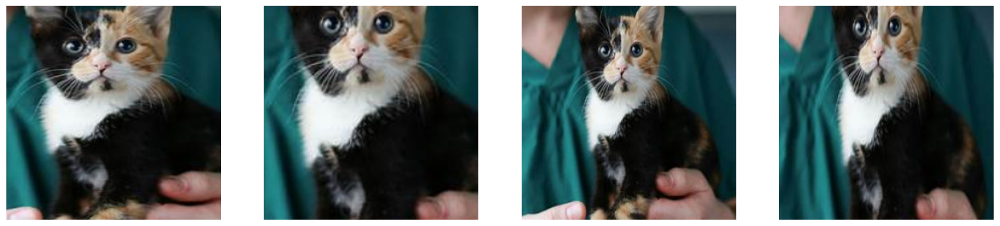

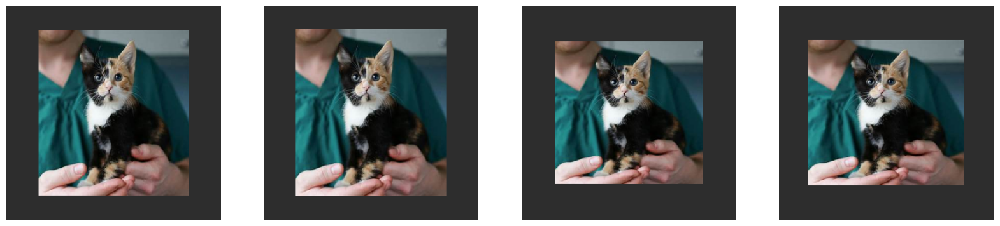

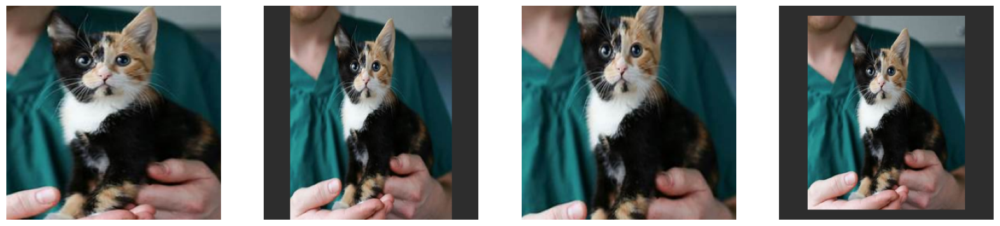

In [15]:
# Zoom in: 확대
idg = ImageDataGenerator(zoom_range=[0.5, 0.9])
show_aug_image_batch(image, idg)

# Zoom out: 축소
idg = ImageDataGenerator(zoom_range=[1.1, 1.5], fill_mode='constant', cval=45)
show_aug_image_batch(image, idg)

# 1보다 작으면 확대, 1보다 크면 축소
idg = ImageDataGenerator(zoom_range=[0.5, 1.5], fill_mode='constant', cval=45)
show_aug_image_batch(image, idg)

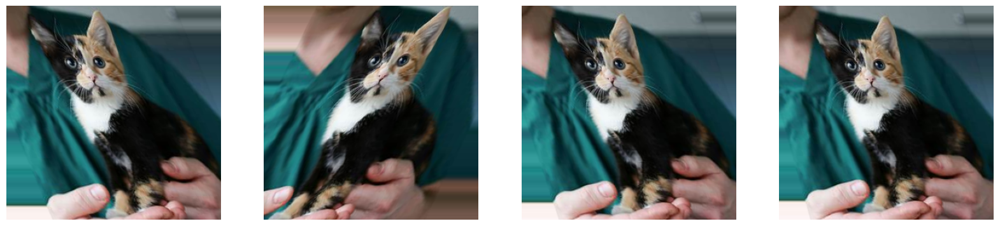

In [16]:
# Shear: 늘리기(0 ~ n)
idg = ImageDataGenerator(shear_range=45)
show_aug_image_batch(image, idg)

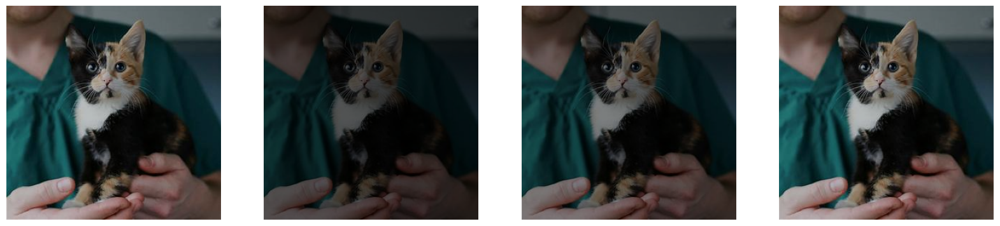

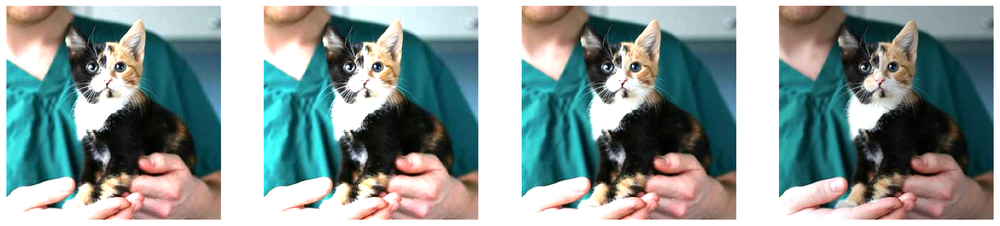

In [17]:
# Brightness: 밝기 조절
# 1보다 작으면 어두워짐, 1보다 크면 밝아짐

# 어둡게
idg = ImageDataGenerator(brightness_range=(0.1, 0.9))
show_aug_image_batch(image, idg)

# 밝게
idg = ImageDataGenerator(brightness_range=(1.1, 1.9))
show_aug_image_batch(image, idg)

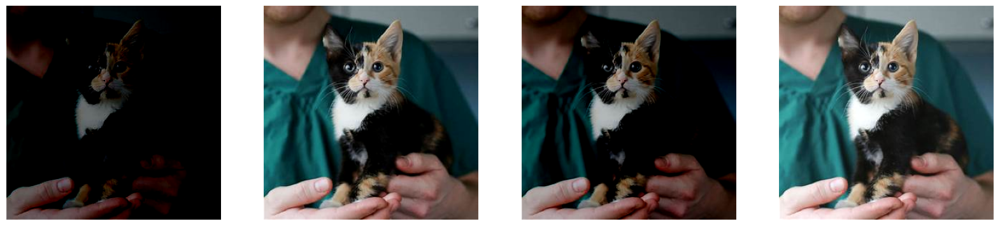

In [18]:
# Channel Shift: 채널 변경
# RGB 채널을 임의의 값으로 변경
idg = ImageDataGenerator(channel_shift_range=150)
show_aug_image_batch(image, idg)

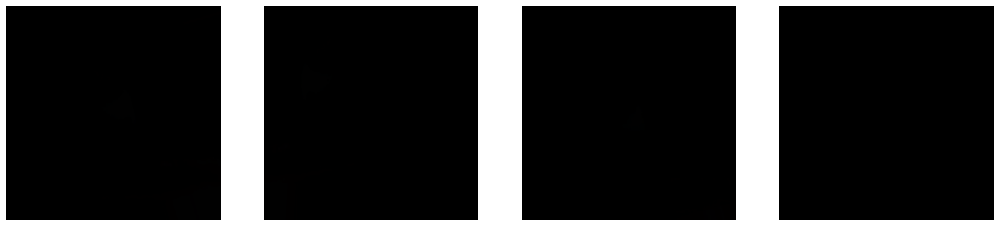

In [19]:
# 다양한 이미지 전처리 적용
# rescale 사용 시 다 검은색으로 나오지만 해줘야 함
idg = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    brightness_range=(0.7, 1.3),
    horizontal_flip=True,
    vertical_flip=True,
    rescale=1./255
)
show_aug_image_batch(image, idg)

### albumentations

In [20]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# 경로 지정
root = './datasets/animals/original/'

# 이미지의 픽셀 값을 0에서 255 사이에서 0에서 1 사이의 값으로 조정
# ImageDataGenerator: 이미지 데이터를 증강하고 전처리하는 데 사용되는 클래스
idg = ImageDataGenerator(rescale=1./255)

# 디렉토리에서 이미지를 가져와 배치로 변환
# flow_from_directory(): 디렉토리를 통해서 가져옴
generator = idg.flow_from_directory(
    root,
    target_size=(250, 250),
    batch_size=32,
    class_mode='categorical'
)

# 각 클랙스의 이름과 인덱스 출력
print(generator.class_indices)

Found 26179 images belonging to 10 classes.
{'butterfly': 0, 'cat': 1, 'chicken': 2, 'cow': 3, 'dog': 4, 'elephant': 5, 'horse': 6, 'sheep': 7, 'spider': 8, 'squirrel': 9}


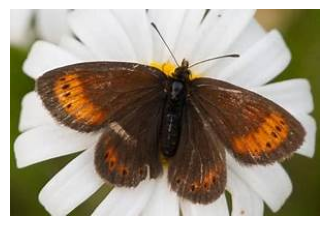

In [21]:
import cv2
import matplotlib.pyplot as plt

# generator에 저장된 경로로 이미지를 불러와 RGB로 변환
image = cv2.cvtColor(cv2.imread(generator.filepaths[803]), cv2.COLOR_BGR2RGB)

# 이미지 출력 함수 선언
def show_image(image):
    plt.figure(figsize=(4, 4))
    plt.imshow(image)
    plt.axis('off')

# 함수 사용을 통해 이미지 출력
show_image(image)

In [22]:
# # cmd 창에서 albumentations 설치
# conda install -c conda-forge albumentations

In [23]:
# 이미지 시각화 함수 선언
def show_images(images, targets, ncols=4, title=None):
    # 그래프 크기 지정
    figure, axs = plt.subplots(figsize=(ncols * 5, 4), nrows=1, ncols=ncols)
    
    # 이미지 객체 반복하여 호출:
    for i in range(ncols):
        # 이미지 출력
        axs[i].imshow(images[i])
        # 이미지 타이틀 지정
        axs[i].set_title(targets[i])

def repeat_aug(original_image=None, target=None, aug=None, ncols=2):
    # 원본 이미지를 포함하는 리스트 초기화
    image_list = [original_image]
    # 원본 이미지 레이블을 포함하는 리스트 초기화
    target_list = ['Original']

    # 증강된 이미지 생성
    aug_image = aug(image=original_image)['image']
    # 증강된 이미지를 리스트에 추가
    image_list.append(aug_image)
    # 증강된 이미지에 대한 레이블을 리스트에 추가
    target_list.append(target)

    # 이미지 리스트와 클래스 타겟 리스트를 함수를 통해 시각화
    show_images(image_list, target_list, ncols=ncols)

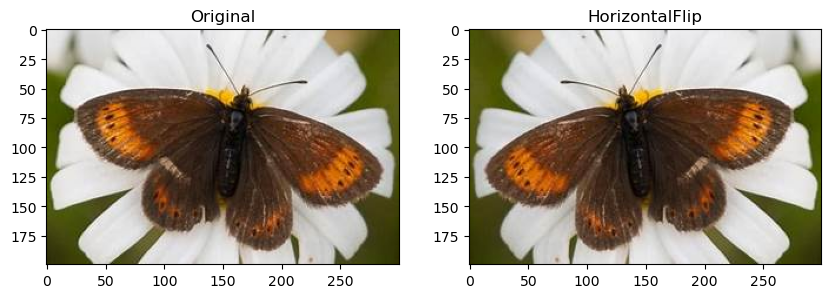

In [24]:
import albumentations as A

# p는 이미지 전처리가 적용될 확률을 의미하며, 1로 설정하면 전처리가 반드시 적용
# aug는 함수 형태로 호출할 수 있으며, 이미지를 입력으로 넣으면 해당 전처리가 적용된 이미지 반환

# 좌우 반전
aug = A.HorizontalFlip(p=1)

# # 이미지는 dict으로 되어 있기 때문에 ['image'] 이렇게 바로 불러올 수 있음
# aug(image=image)['image']

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='HorizontalFlip', aug=aug)

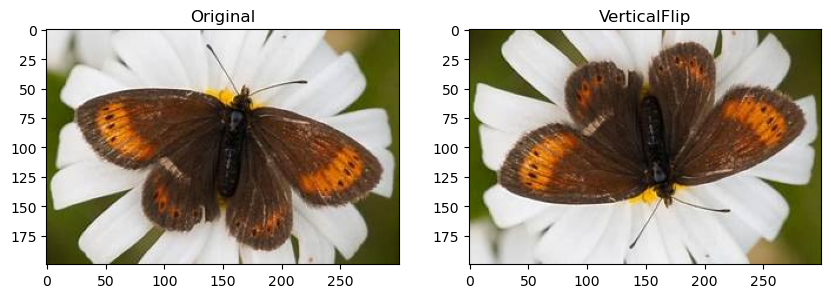

In [25]:
# 상하 반전
aug = A.VerticalFlip(p=1)

repeat_aug(original_image=image, target='VerticalFlip', aug=aug)

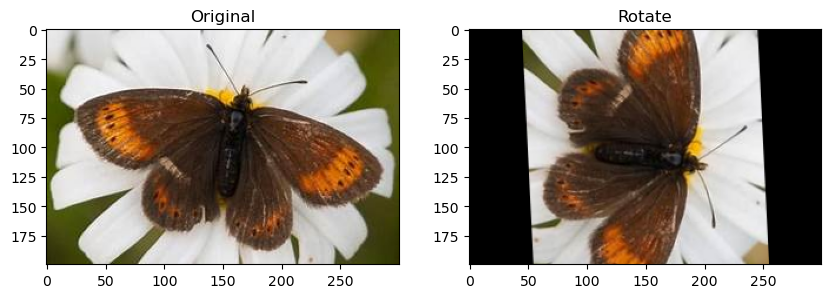

In [26]:
# limit=90 일 경우 -90 ~ 90 범위를 갖는다.

# # 거울처럼 반사
# aug = A.Rotate(p=1, limit=90, border_mode=cv2.BORDER_REFLECT)

# # 잘린부분으로 채우기
# aug = A.Rotate(p=1, limit=90, border_mode=cv2.BORDER_WRAP)

# 이미지 회전 후 여백 검은색으로 채우기
aug = A.Rotate(p=1, limit=90, border_mode=cv2.BORDER_CONSTANT)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Rotate', aug=aug)

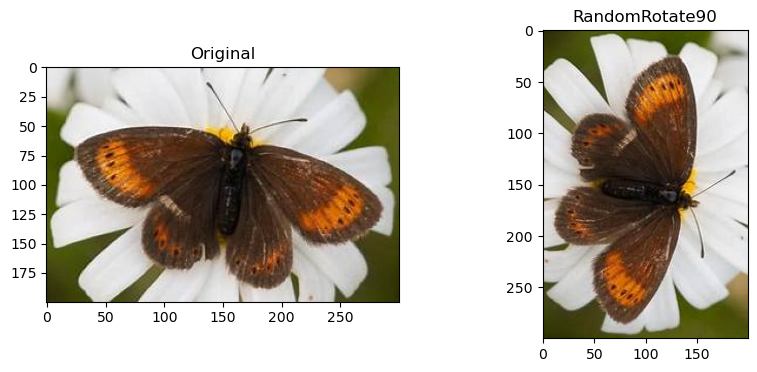

In [27]:
# 랜덤한 값으로 회전
aug = A.RandomRotate90(p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='RandomRotate90', aug=aug)

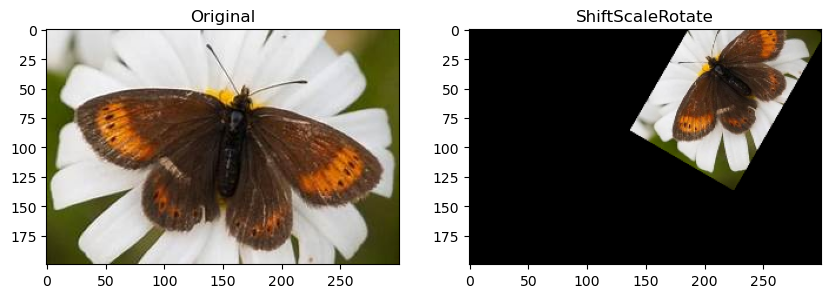

In [28]:
# 이미지 축소 및 회전 후 여백 검은색으로 채우기
# shift와 scale(zoom), rotate를 함께 또는 별개로 적용, 별개로 적용할 경우 나머지 0으로 설정
aug = A.ShiftScaleRotate(shift_limit=0.5, scale_limit=(-0.8, 1.5), rotate_limit=90, p=1, border_mode=cv2.BORDER_CONSTANT)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='ShiftScaleRotate', aug=aug)

In [29]:
# 이미지 시각화 함수 선언
def show_images(images, targets, ncols=4, title=None):
    # 그래프 크기 지정
    figure, axs = plt.subplots(figsize=(ncols * 5, 4), nrows=1, ncols=ncols)
    # 이미지 객체 반복하여 호출:
    for i in range(ncols):
        # 이미지 출력
        axs[i].imshow(images[i])
        # 이미지 타이틀 지정
        axs[i].set_title(targets[i])

# 이미지 전처리 후 시각화
def repeat_aug(original_image=None, target=None, aug=None, ncols=2):
    # 원본 이미지를 포함하는 리스트 초기화
    image_list = [original_image]
    # 원본 이미지 레이블을 포함하는 리스트 초기화
    target_list = ['Original']

    # 반복하여 이미지 객체 호출
    for i in range(ncols):
        # 증강된 이미지 생성
        aug_image = aug(image=original_image)['image']
        # 증강된 이미지를 리스트에 추가
        image_list.append(aug_image)
        # 증강된 이미지에 대한 레이블을 리스트에 추가
        target_list.append(target)

    # 이미지 리스트와 클래스 타겟 리스트를 함수를 통해 시각화
    show_images(image_list, target_list, ncols=ncols)

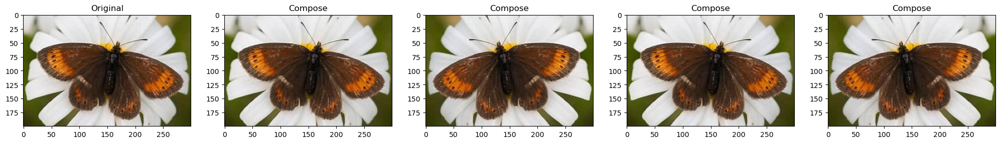

In [30]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.VerticalFlip(p=0.5),
    A.HorizontalFlip(p=0.5)
])

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Compose', aug=aug, ncols=5)

In [31]:
# 이미지 형태 출력
image.shape

(200, 300, 3)

(100, 50, 3)

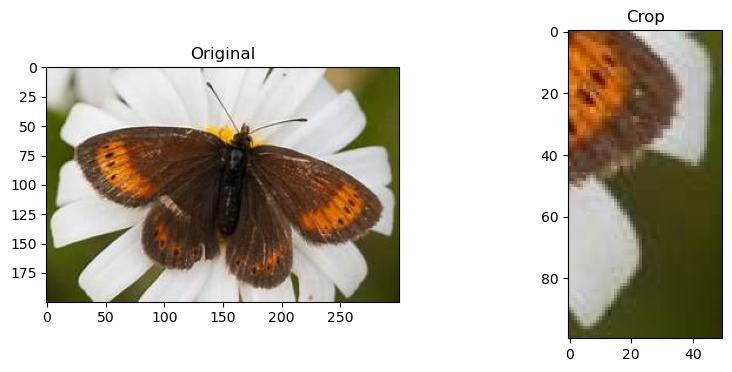

In [32]:
# 특정 영역을 잘라낸 후 원본 사이즈로 다시 Resize하지 않음
# x: width, y:height, max값은 이미지 크기로 설정해야한다.
# 범위가 아닌 지정한 부분을 제외한 나머지 부분을 가져온다.
aug = A.Crop(x_min=250, y_min=100, x_max=300, y_max=200, p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Crop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(250, 250, 3)

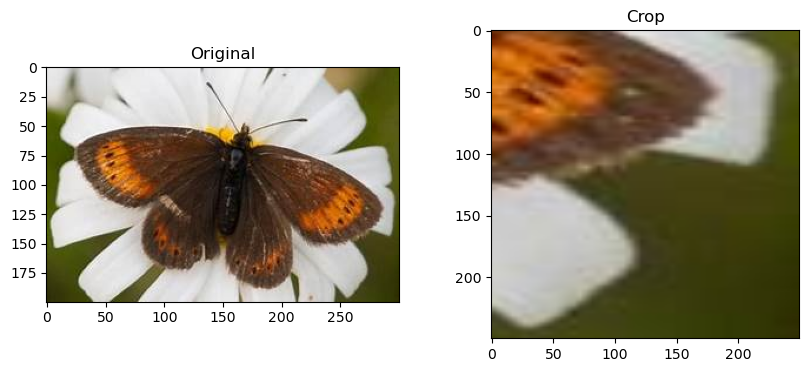

In [33]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.Crop(x_min=250, y_min=100, x_max=300, y_max=200, p=1),
    A.Resize(250, 250)
])

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Crop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(100, 200, 3)

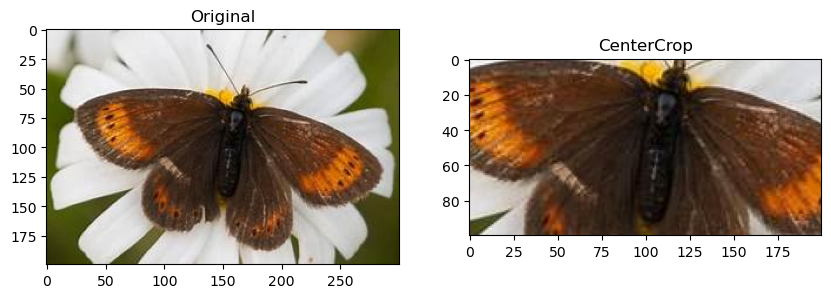

In [34]:
# 센터 크롭
aug = A.CenterCrop(height=100, width=200, p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='CenterCrop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(250, 250, 3)

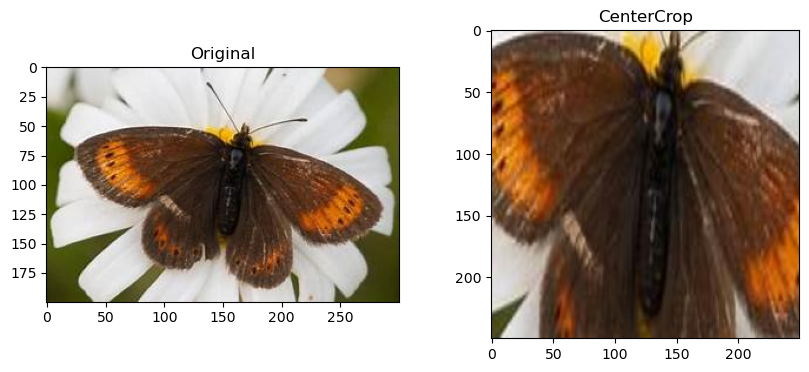

In [35]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.CenterCrop(height=100, width=200, p=1),
    A.Resize(250, 250)
])

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='CenterCrop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(100, 200, 3)

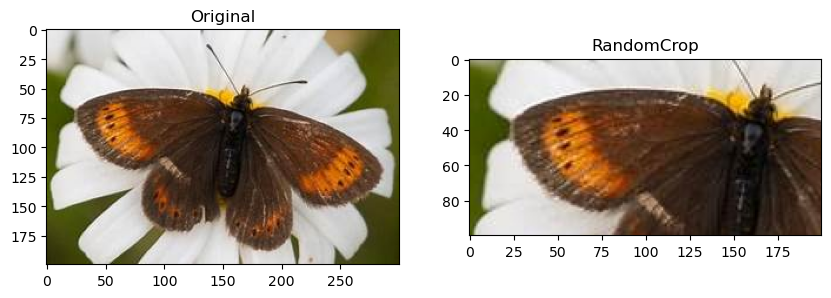

In [36]:
# 랜덤한 부분을 크롭
aug = A.RandomCrop(height=100, width=200, p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='RandomCrop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(250, 250, 3)

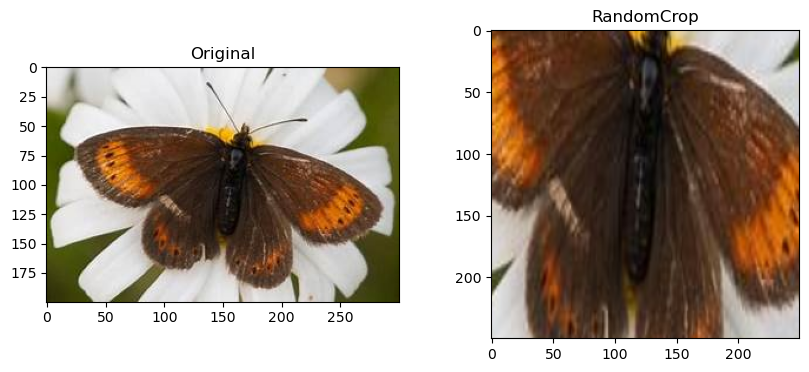

In [37]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.RandomCrop(height=100, width=200, p=1),
    A.Resize(250, 250)
])

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='RandomCrop', aug=aug)

# 이미지 형태 출력
aug(image=image)['image'].shape

(250, 250, 3)

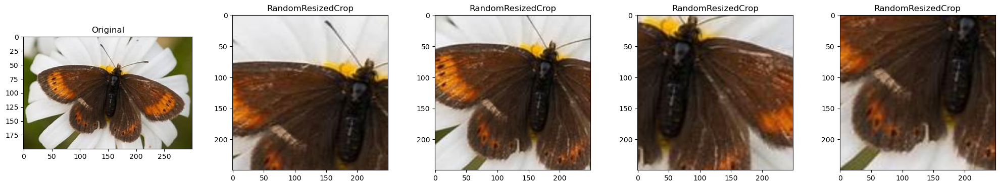

In [38]:
# 특정 영역을 scale 범위만큼 잘라낸 후, 전달한 width와 height 크기로 Resize한다.
# 원본 이미지가 100 X 100일 경우 scale(0.1, 0.5)를 적용하면,
# 10 ~ 50% 범위의 랜덤한 영역을 잘라낸 후 resize해준다.
aug = A.RandomResizedCrop(height=250, width=250, scale=(0.2, 0.5), p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='RandomResizedCrop', aug=aug, ncols=5)

# 이미지 형태 출력
aug(image=image)['image'].shape

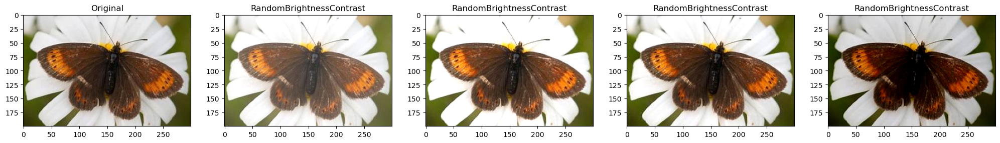

In [39]:
# 밝기, 대비
# 0.2 == (-0.2, 0.2)
# 개별 작업 진행 시, 나머지는 0을 전달한다.
aug = A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='RandomBrightnessContrast', aug=aug, ncols=5)

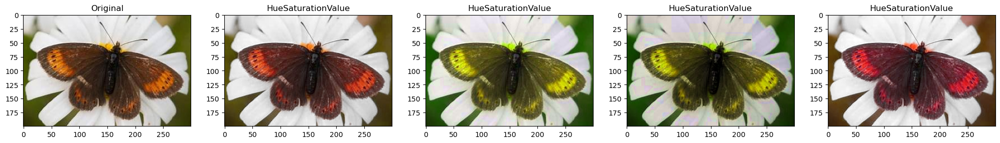

In [40]:
# 색상, 채도, 명도
# hue_shift_limit
# sat_shift_limit
# val_shift_limit
aug = A.HueSaturationValue(p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='HueSaturationValue', aug=aug, ncols=5)

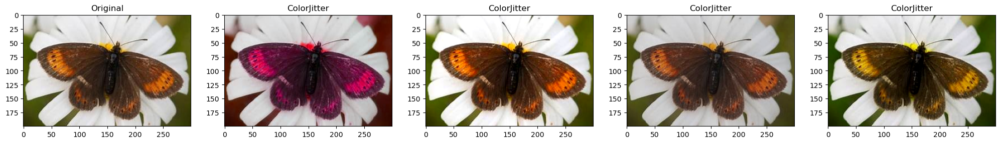

In [41]:
# 밝기, 대비, 채도, 색상
aug = A.ColorJitter(p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='ColorJitter', aug=aug, ncols=5)

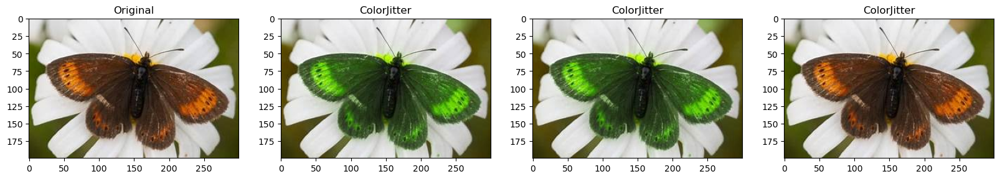

In [42]:
# 채널 위치 변경
aug = A.ChannelShuffle(p=1)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='ColorJitter', aug=aug, ncols=4)

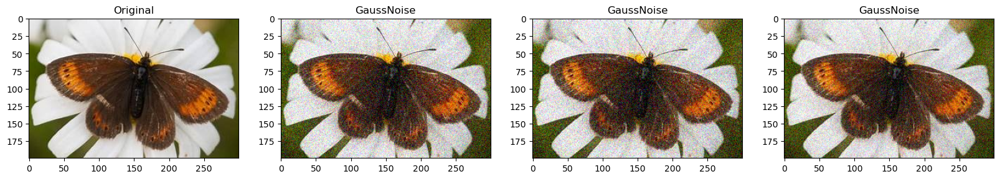

In [43]:
# 가우시안 분포(정규 분포)를 사용해서 Noise를 생성한다.
aug = A.GaussNoise(p=1, var_limit=(400, 900))

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='GaussNoise', aug=aug, ncols=4)

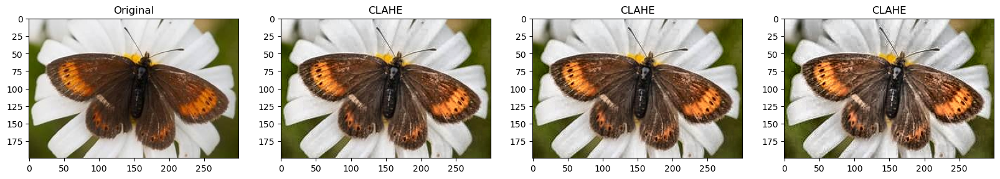

In [44]:
# 명암대비가 선명한 정도 조정
# 어두운 이미지가 많은 경우에 사용
aug = A.CLAHE(p=1, clip_limit=4)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='CLAHE', aug=aug, ncols=4)

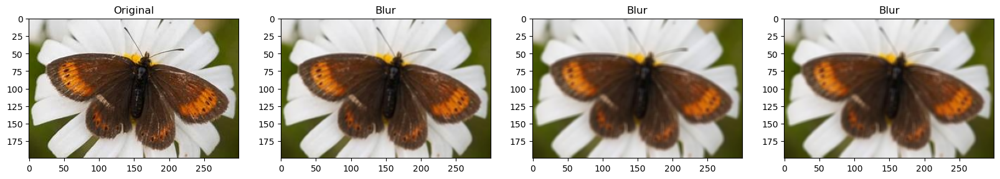

In [45]:
# 흐려지게 하기
aug = A.Blur(p=1, blur_limit=(3, 5))

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Blur', aug=aug, ncols=4)

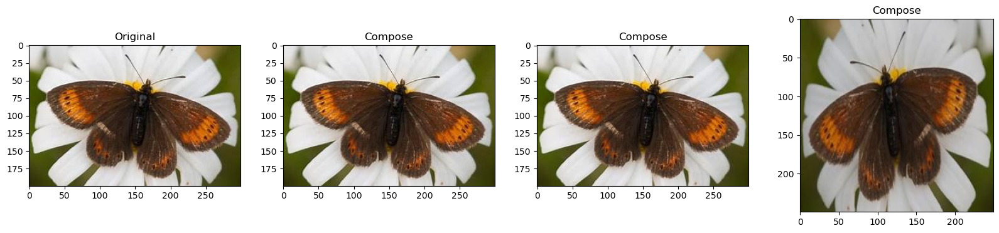

In [46]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.CenterCrop(height=100, width=100, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.Resize(250, 250, p=1)
], p=0.5)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Compose', aug=aug, ncols=4)

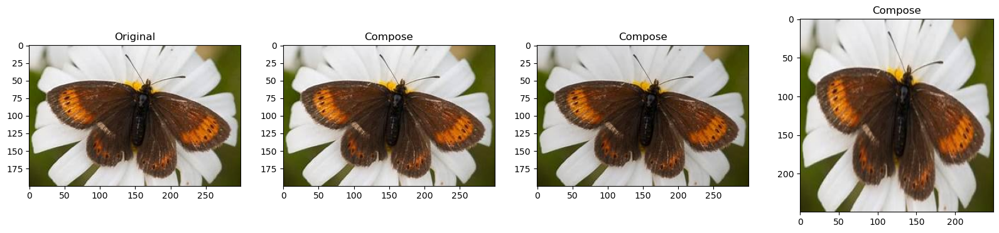

In [47]:
# 이미지 전처리 list로 전달
# 여러 개 중 한 개만 골라서 적용
aug = A.OneOf([
    A.CenterCrop(height=100, width=100, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.Resize(250, 250, p=1)
], p=0.5)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Compose', aug=aug, ncols=4)

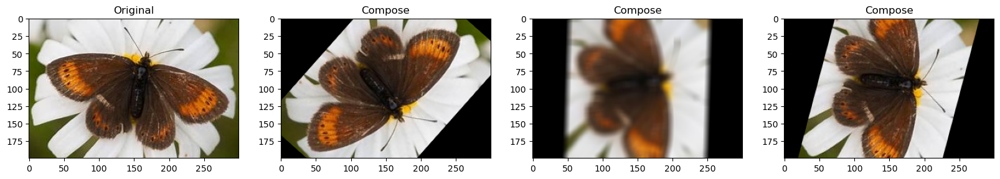

In [48]:
# 이미지 전처리 list로 전달
aug = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=1),
    A.Rotate(limit=(45, 90), p=1, border_mode=cv2.BORDER_CONSTANT),
    A.OneOf([
        A.CLAHE(p=0.3),
        A.Blur(blur_limit=(10, 15), p=0.3)
    ], p=0.5)
])

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Compose', aug=aug, ncols=4)

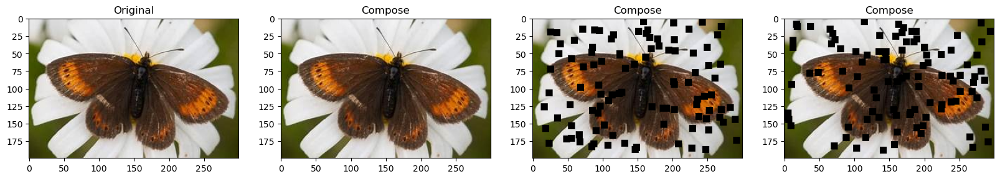

In [49]:
# 검은색 정사각형을 랜덤하게 배치하여 noise를 발생시킨다.
aug = A.CoarseDropout(max_holes=100, max_height=10, max_width=10, p=0.5)

# repeat_aug 함수를 호출하여 원본 이미지와 증강된 이미지를 시각화
repeat_aug(original_image=image, target='Compose', aug=aug, ncols=4)

### 🚩정리
#### 기본적으로 많이 사용되는 변환은 아래와 같다.

- Vertical (상하)
- Horizontal (좌우)
- ShiftScaleRotation (이동, zoom, 회전)
- RandomCrop(랜덤 크롭), CenterCrop(센터 크롭), RandomBrightnessContrast (밝기, 대비)
- ColorJitter (색상, 채도, 명도)
- CLAHE(명암 대비를 통한 선명도 조정), Blur (블러-nosie), CoarseDropout (noise 추가)

- 이렇게 쓰게 되면 똑같은 것으로 fit을 2~3번 해야 하며, p는 웬만하면 0.5로 진행해야 한다.
- X-ray 같은 데이터에는 사용하지 말고 항상 상황에 맞게 이미지 전처리를 진행해야 한다.

In [50]:
import albumentations as A
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# 이미지 전처리 함수 선언
def transform(image):
    aug = A.Compose([
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.OneOf([
            A.ColorJitter(p=0.5),
            A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2, p=0.5)    
        ], p=1)
    ], 0.5)

    return aug(image=image)['image']

# 이미지 전처리 객체 생성 (이미지 전처리 함수 받고, 1/255로 스케일링하여 정규화 진행)
idg = ImageDataGenerator(preprocessing_function=transform, rescale=1./255)